# ___THE SPARKS FOUNDATION___

## _TASK 3_

### _EXPLORATORY DATA ANALYSIS (EDA) FOR SAMPLE SUPERSTORE DATASET_
***

In [112]:
# Importing the necessary libraries
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
%matplotlib inline
import seaborn as sns 
import missingno 

In [113]:
# Reading the dataset
data = pd.read_csv('SampleSuperstore.csv')
data.head(5)

,Ship Mode,Segment,Country,City,State,Postal Code,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,United States,Los Angeles,California,90036,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


In [114]:
data.shape # The number of rows and coloumns of the dataset

(9994, 13)

In [115]:
# Knowing about the data format/ data types of the various columns
data.info()

data.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Ship Mode     9994 non-null   object 
 1   Segment       9994 non-null   object 
 2   Country       9994 non-null   object 
 3   City          9994 non-null   object 
 4   State         9994 non-null   object 
 5   Postal Code   9994 non-null   int64  
 6   Region        9994 non-null   object 
 7   Category      9994 non-null   object 
 8   Sub-Category  9994 non-null   object 
 9   Sales         9994 non-null   float64
 10  Quantity      9994 non-null   int64  
 11  Discount      9994 non-null   float64
 12  Profit        9994 non-null   float64
dtypes: float64(3), int64(2), object(8)
memory usage: 1015.1+ KB


,Postal Code,Sales,Quantity,Discount,Profit
count,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000
mean,55190.379428,229.858001,3.789574,0.156203,28.656896
std,32063.693350,623.245101,2.225110,0.206452,234.260108
min,1040.000000,0.444000,1.000000,0.000000,-6599.978000
25%,23223.000000,17.280000,2.000000,0.000000,1.728750
50%,56430.500000,54.490000,3.000000,0.200000,8.666500
75%,90008.000000,209.940000,5.000000,0.200000,29.364000
max,99301.000000,22638.480000,14.000000,0.800000,8399.976000


### 1) We come to see that there are no missing values in the dataset.
### 2) In the sales and profit columns the difference between the max and the 75% is alot, which tells us that there are outliners in the dataset

*** 

In [118]:
print (data.describe(include = 'all'))

             Ship Mode   Segment        Country           City       State  \
count             9994      9994           9994           9994        9994   
unique               4         3              1            531          49   
top     Standard Class  Consumer  United States  New York City  California   
freq              5968      5191           9994            915        2001   
mean               NaN       NaN            NaN            NaN         NaN   
std                NaN       NaN            NaN            NaN         NaN   
min                NaN       NaN            NaN            NaN         NaN   
25%                NaN       NaN            NaN            NaN         NaN   
50%                NaN       NaN            NaN            NaN         NaN   
75%                NaN       NaN            NaN            NaN         NaN   
max                NaN       NaN            NaN            NaN         NaN   

         Postal Code Region         Category Sub-Category      

In [119]:
# generate count statistics of duplicate entries
if len(data[data.duplicated()]) > 0:
    print("No. of duplicated entries: ", len(data[data.duplicated()]))
    print(data[data.duplicated(keep=False)].sort_values(by=list(data.columns)).head())
else:
    print("No duplicated entries found")

No. of duplicated entries:  17
         Ship Mode      Segment        Country           City       State  \
6409   First Class     Consumer  United States        Houston       Texas   
8032   First Class     Consumer  United States        Houston       Texas   
5493      Same Day  Home Office  United States  San Francisco  California   
5905      Same Day  Home Office  United States  San Francisco  California   
2807  Second Class     Consumer  United States        Seattle  Washington   

      Postal Code   Region         Category Sub-Category   Sales  Quantity  \
6409        77041  Central  Office Supplies        Paper  47.952         3   
8032        77041  Central  Office Supplies        Paper  47.952         3   
5493        94122     West  Office Supplies       Labels  41.400         4   
5905        94122     West  Office Supplies       Labels  41.400         4   
2807        98115     West  Office Supplies        Paper  12.960         2   

      Discount   Profit  
6409       

In [120]:
data = data.drop_duplicates() #Dropping the duplicated entries
data.drop(['Postal Code', 'Country'], axis=1, inplace=True)

In [121]:
data.shape # rechecking the shape of the dataset. 

(9977, 11)

In [122]:
print('Ship Modes: ', pd.unique(data['Ship Mode'])) # The different types of Shiping modes
print('Segments: ', pd.unique(data['Segment'])) # The different segments of the segments
print('Category: ', data.Category.unique())
print('Sub-Category: ', pd.unique(data['Sub-Category']))

Ship Modes:  ['Second Class' 'Standard Class' 'First Class' 'Same Day']
Segments:  ['Consumer' 'Corporate' 'Home Office']
Category:  ['Furniture' 'Office Supplies' 'Technology']
Sub-Category:  ['Bookcases' 'Chairs' 'Labels' 'Tables' 'Storage' 'Furnishings' 'Art'
 'Phones' 'Binders' 'Appliances' 'Paper' 'Accessories' 'Envelopes'
 'Fasteners' 'Supplies' 'Machines' 'Copiers']


### Therefore we can see that:
### 1) There are 4 Types of ship modes. 
### 2) There are 3 segments of people. 
### 3) The categories and products which are sold.
***

In [123]:
corr = data.corr()
corr

,Sales,Quantity,Discount,Profit
Sales,1.000000,0.200722,-0.028311,0.479067
Quantity,0.200722,1.000000,0.008678,0.066211
Discount,-0.028311,0.008678,1.000000,-0.219662
Profit,0.479067,0.066211,-0.219662,1.000000


<AxesSubplot:>

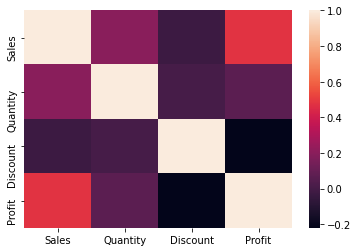

In [124]:
sns.heatmap(corr)

***

Consumer       51.949484
Corporate      30.219505
Home Office    17.831011
Name: Segment, dtype: float64


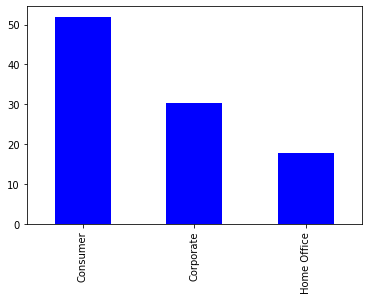

In [125]:
#UNIVARIATE ANALYSIS

# Analysing the segment of people buying from supermarket.
print(data['Segment'].value_counts()/len(data['Segment'])*100)
s = (data['Segment'].value_counts()/len(data['Segment'])*100).plot(kind='bar', color='b')

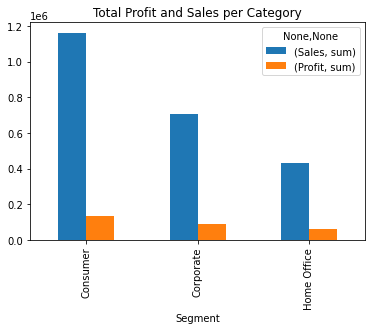

In [190]:
data.groupby('Segment')['Sales','Profit'].agg(['sum']).plot.bar()
plt.title('Total Profit and Sales per Category')
plt.show()

### _Following conclusions can be made that:_

### _1) About 50% of the people belong to thge consumer class_
### _2) The remaining 30% and 20% belongs to the respective corporate and home office class._

Standard Class    59.687281
Second Class      19.474792
First Class       15.405432
Same Day           5.432495
Name: Ship Mode, dtype: float64


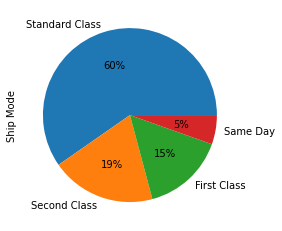

In [136]:
# Analysis of Ship modes of the products sold
print(data['Ship Mode'].value_counts()/len(data['Ship Mode'])*100)
s1 = (data['Ship Mode'].value_counts()/len(data['Ship Mode'])*100).plot(kind='pie', autopct='%1.0f%%', labeldistance=1.1)

### _Conclusions:_
### _1) Most of the deliveries were done under the standard class, i.e. upto 60%._
### _2) A very small percentage of the deliveries were done on the same day._
### _3) The rest belongs to the first and second class deliveries, i.e, 15% and 19% respectively._ 

Office Supplies    60.258595
Furniture          21.228826
Technology         18.512579
Name: Category, dtype: float64


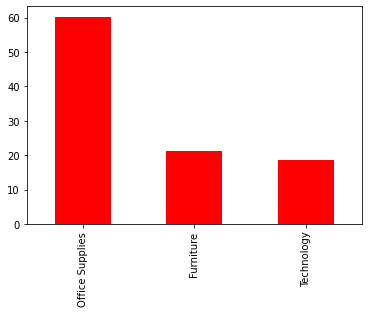

In [128]:
# Analysis of the product's categories which were sold. 
print(data['Category'].value_counts()/len(data['Category'])*100)
s2 = (data['Category'].value_counts()/len(data['Category'])*100).plot(kind='bar', color='r')

### _We can conclude that the number of products which were sold maximum were from the office supplies category._

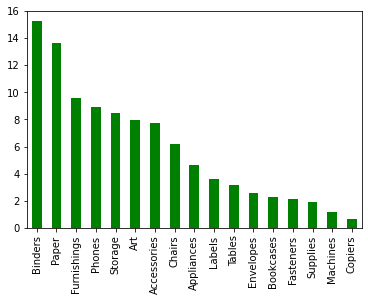

In [129]:
# Analysis of the Sub category products.
s3 = (data['Sub-Category'].value_counts()/len(data['Sub-Category'])*100).plot(kind='bar', color='g')

### _Conclusions:_
### _1) About 9-15% of the sub-category items falls under the office supplies category._ 
### _2) the rest 2-8% belongs to the furniture and technology categories._

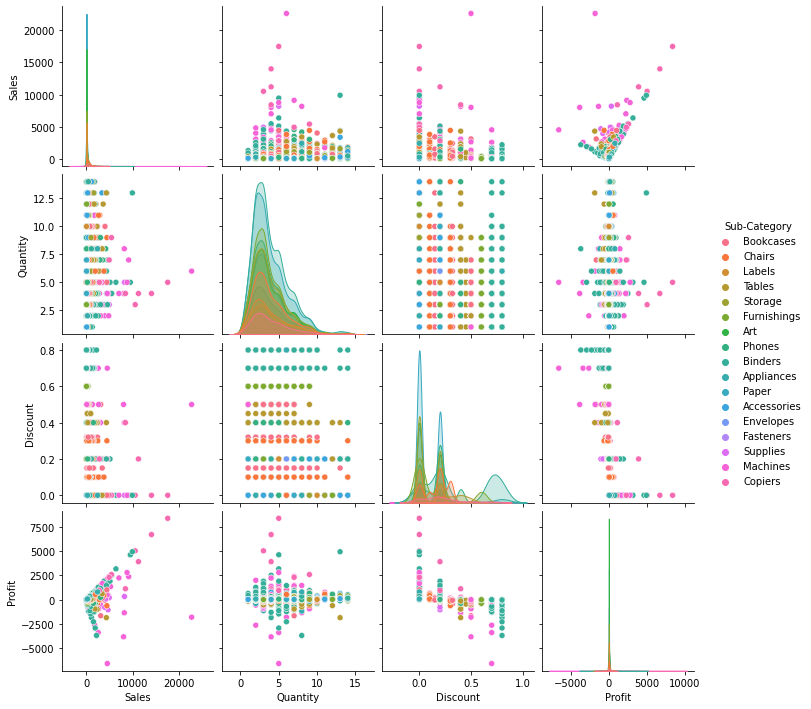

In [141]:
figsize = (15,10)
sns.pairplot(data, hue ='Sub-Category')

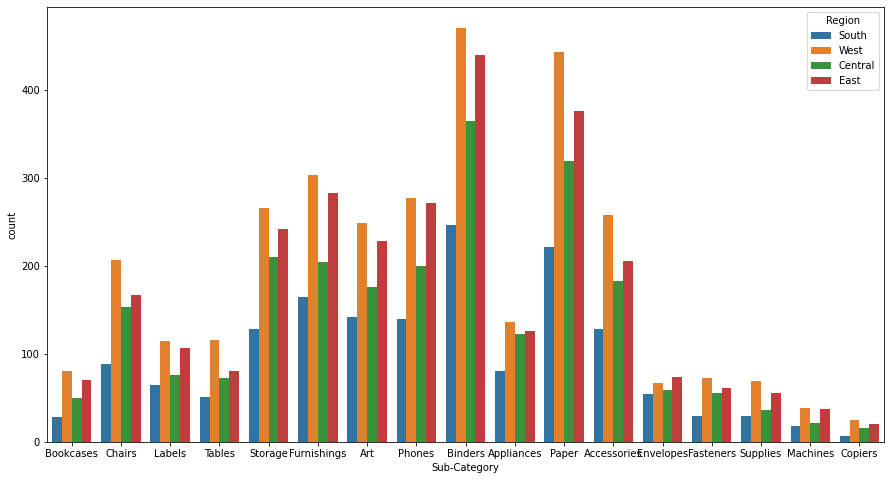

In [188]:
#Count of Sub-Category region wise
plt.figure(figsize=(15,8))
sns.countplot(x='Sub-Category',hue="Region",data=data)
plt.show()

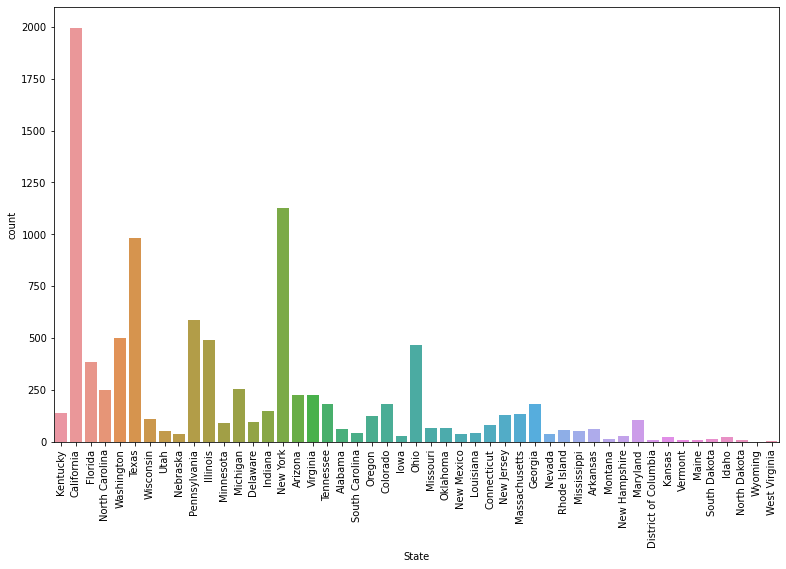

In [142]:

plt.figure(figsize=(13,8))
sns.countplot(x=data['State'])
plt.xticks(rotation=90)
plt.show()

In [150]:
top_state=data.groupby('State').sum().sort_values('Profit',ascending=False)
top_state.head(15)

,Sales,Quantity,Discount,Profit
State,,,,
California,457576.2715,7649,145.6,76330.7891
New York,310827.1510,4220,62.4,74015.4622
Washington,138560.8100,1871,32.4,33368.2375
Michigan,75879.6440,943,1.8,24428.0903
Virginia,70636.7200,893,0.0,18597.9504
Indiana,53555.3600,578,0.0,18382.9363
Georgia,49095.8400,705,0.0,16250.0433
Kentucky,36591.7500,523,0.0,11199.6966
Minnesota,29863.1500,331,0.0,10823.1874


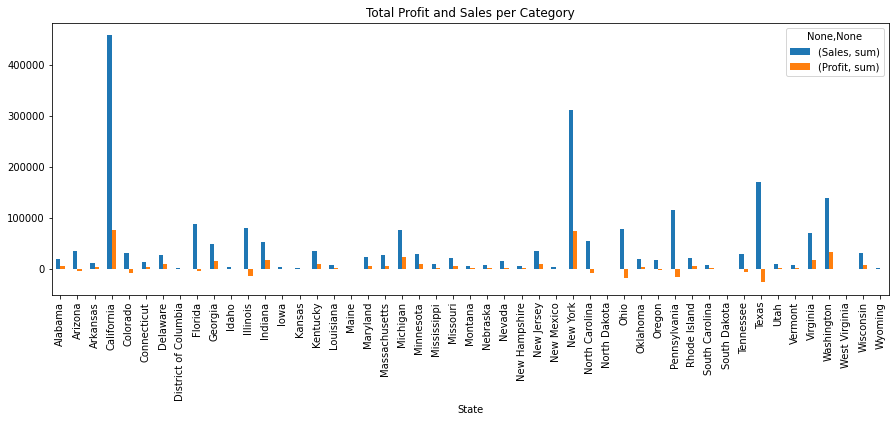

In [199]:

data.groupby('State')['Sales','Profit'].agg(['sum']).plot.bar(title='Total Profit and Sales per Category', figsize=(15,5))
plt.show()

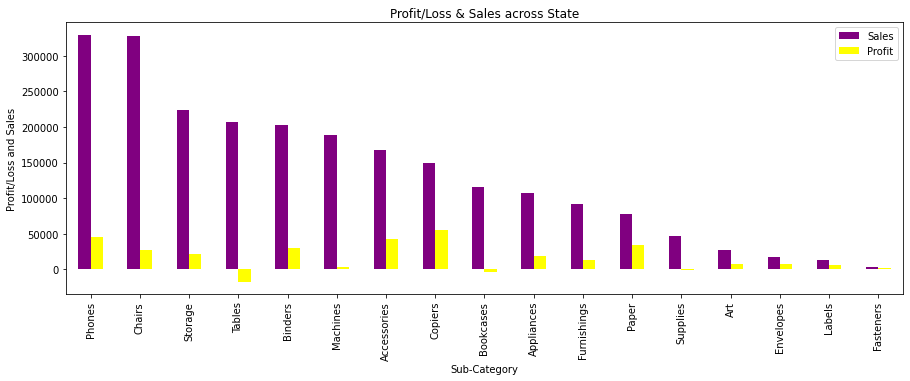

In [192]:
ps=data.groupby('Sub-Category')[['Sales','Profit']].sum().sort_values(by='Sales',ascending=False)
ps[:].plot.bar(color=['Purple','yellow'],figsize=(15,5))
plt.title('Profit/Loss & Sales across State')
plt.xlabel('Sub-Category')
plt.ylabel('Profit/Loss and Sales')
plt.show()

### _Conclusions:_
### _1) Higher Numbers of Buyers are from Calofornia and New York._
### _2) Most Customers tends to Buy quantity of 2 and 3._
### _3) There IS NO CORRELATION between Profit and Discount._
### _4) Profit and Sales are maximum in customer segments and minimum in Home office segments._
### _5) segments wise sales are almost same in every region._
### _6) Profits and sales are maximum in west region and minimum in south region._
### _7) High profit for california and new york._
### _8) Loss for Texas,Pennsylvania and Ohlo._

***

In [187]:
data.pivot_table(values='Profit', index='Segment', columns='Discount', aggfunc='sum')

Discount,0.00,0.10,0.15,0.20,0.30,0.32,0.40,0.45,0.50,0.60,0.70,0.80
Segment,,,,,,,,,,,,
Consumer,157810.0061,4681.5045,456.5945,42949.4970,-6338.4144,-1335.2122,-8972.3559,-1299.9114,-9382.1707,-2859.3468,-22462.1110,-19240.6384
Corporate,102125.8344,2694.6798,689.9500,26209.0418,-2543.2759,-827.0201,-9768.2636,-842.9059,-6598.8014,-1584.3097,-9183.2091,-8416.7405
Home Office,60908.5668,1652.9927,272.4470,21148.0682,-1475.5283,-228.9054,-4316.4309,-350.2938,-4525.4560,-1500.9987,-8430.0368,-2875.4233


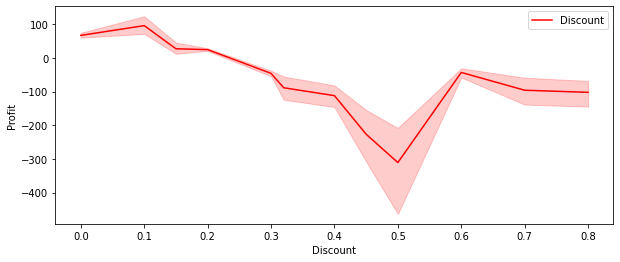

In [186]:
plt.figure(figsize =(10,4))
sns.lineplot('Discount','Profit',data = data,color = 'r',label = 'Discount')
plt.legend()

### _We can see from the above that the products having the discounts between 0%-20% are having good number of sales and gaining profit._ 
### _For discounts >30% the store is getting loss. Hence, it is suggested to provide discounts of upto 20% only for any products so that the store can be in profit._  
### _For the products to be sold at profit it is suggested to use the standard delivery shipping mode._ 
### _Scope of investment in Technology category can be seen._
***

## ___TASK 3 COMPLETED___
## _THANK YOU_